In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/car-number-plate-video/pexels-george-morina-6719160 (2160p).mp4
/kaggle/input/car-number-plate-video/pexels-george-morina-5293898 (1080p).mp4
/kaggle/input/car-number-plate-video/pexels-casey-whalen-6571483 (2160p).mp4
/kaggle/input/car-number-plate-video/Automatic Number Plate Recognition (ANPR) _ Vehicle Number Plate Recognition (1).mp4
/kaggle/input/car-number-plate-video/Traffic Control CCTV.mp4
/kaggle/input/car-number-plate-video/pexels-george-morina-5222550 (2160p).mp4
/kaggle/input/car-number-plate-video/pexels-christopher-schultz-5927708 (1080p).mp4
/kaggle/input/car-number-plate-video/pexels-taryn-elliott-5309381 (1080p).mp4


# 1. Install required libraries and YOLOv12

In [2]:
!pip install -q datasets==2.19.1 roboflow supervision flash-attn
!pip install -q git+https://github.com/sunsmarterjie/yolov12.git

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 76.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 542.0/542.0 kB 36.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 36.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.2/207.2 kB 12.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 8.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 172.0/172.0 kB 13.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.8/16.8 MB 98.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 61.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 88.4 MB/s eta 0:00:00
   ━━━━━━

In [3]:
# Clone the official YOLOv12 repo
!git clone https://github.com/sunsmarterjie/yolov12.git
%cd yolov12
!pip install -e . --quiet

Cloning into 'yolov12'...
remote: Enumerating objects: 1163, done.
remote: Counting objects: 100% (489/489), done.
remote: Compressing objects: 100% (186/186), done.
remote: Total 1163 (delta 333), reused 303 (delta 303), pack-reused 674 (from 2)
Receiving objects: 100% (1163/1163), 1.80 MiB | 19.82 MiB/s, done.
Resolving deltas: 100% (582/582), done.
/kaggle/working/yolov12
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
  Building editable for ultralytics (pyproject.toml) ... done


# 2. Import dependencies

In [4]:
import os, glob, subprocess, cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import torch, yaml
from base64 import b64encode
from datasets import load_dataset
from IPython.display import FileLink, HTML


# Make sure Kaggle uses YOLOv12 repo, not preinstalled YOLOv8
import sys
sys.path.insert(0, '/kaggle/working/yolov12')  # path to cloned repo
from ultralytics import YOLO

%matplotlib inline

# Clear GPU cache and check device
torch.cuda.empty_cache()
print("✅ GPU:", torch.cuda.get_device_name(0))

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/yolov12/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
FlashAttention is not available on this device. Using scaled_dot_product_attention instead.
✅ GPU: Tesla T4


# 3. Load and prepare dataset

In [5]:
# Using the Hugging Face dataset: license plate object detection
ds = load_dataset("keremberke/license-plate-object-detection", "full")
# Convert splits to pandas DataFrames
df_train, df_val, df_test = ds['train'].to_pandas(), ds['validation'].to_pandas(), ds['test'].to_pandas()

Generating train split:   0%|          | 0/6176 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/1765 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/882 [00:00<?, ? examples/s]

In [6]:
# Function to save images and YOLO-style label txt files
def save_yolo_format(df, subset):
    img_dir, lbl_dir = f'dataset/images/{subset}', f'dataset/labels/{subset}'
    os.makedirs(img_dir, exist_ok=True); os.makedirs(lbl_dir, exist_ok=True)
    for idx, row in df.iterrows():
        img = np.frombuffer(row['image'].get('bytes'), dtype=np.uint8)
        img = cv2.imdecode(img, cv2.IMREAD_COLOR)
        if img is None: continue
        h, w = img.shape[:2]
        cv2.imwrite(f"{img_dir}/image_{idx}.jpg", img)
        with open(f"{lbl_dir}/image_{idx}.txt", "w") as f:
            for bbox, cls in zip(row['objects']["bbox"], row['objects']["category"]):
                x, y, bw, bh = bbox
                xc, yc = (x + bw/2)/w, (y + bh/2)/h
                f.write(f"{cls} {xc} {yc} {bw/w} {bh/h}\n")

# Save all splits (train, val, test)
for s in ["train", "val", "test"]:
    save_yolo_format(eval(f"df_{s}"), s)

# 4. Create dataset YAML config file

In [7]:
yaml_content = f"""
train: dataset/images/train
val: dataset/images/val
test: dataset/images/test

nc: 2
names: ['license_plate', 'car']
"""
with open('dataset.yaml', 'w') as f:
    f.write(yaml_content)

print("📁 Dataset config:")
print(open('dataset.yaml').read())

📁 Dataset config:

train: dataset/images/train
val: dataset/images/val
test: dataset/images/test

nc: 2
names: ['license_plate', 'car']



In [8]:
# Move dataset to Kaggle working directory
!mkdir -p /kaggle/working/datasets
!mv dataset /kaggle/working/datasets/
!ls /kaggle/working/datasets/dataset/images/val | head

image_0.jpg
image_1000.jpg
image_1001.jpg
image_1002.jpg
image_1003.jpg
image_1004.jpg
image_1005.jpg
image_1006.jpg
image_1007.jpg
image_1008.jpg
ls: write error: Broken pipe


# 5. Train YOLOv12 model

In [9]:
model = YOLO("yolov12n.pt")
model.train(
    data="dataset.yaml",
    epochs=30,         # train for 20 epochs
    imgsz=640,         
    batch=16,
    pretrained=True,   # fine-tune from pretrained weights
    mosaic=0.3,        # reduce mosaic (too strong may shrink license plates)
    mixup=0.1,         # slight image blending for better generalization
    degrees=7,         # small rotation ±7°
    translate=0.05,    # light translation (avoid moving plates out of frame)
    scale=0.25,        # small zoom range (avoid tiny plates)
    shear=8,           # mild shearing to simulate camera angles
    flipud=0.0,        # disable vertical flip (cars are never upside-down)
    fliplr=0.0,        # disable horizontal flip (optional: 0.5 if direction doesn’t matter)
)

100%|██████████| 5.26M/5.26M [00:00<00:00, 120MB/s]


New https://pypi.org/project/ultralytics/8.3.222 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.63 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov12n.pt, data=dataset.yaml, epochs=30, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_

100%|██████████| 755k/755k [00:00<00:00, 24.7MB/s]
E0000 00:00:1761730077.369119      19 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1761730077.442839      19 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      2368  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2, 1, 2]          
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1      9344  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2, 1, 4]          
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  2    174720  ultralytics.nn.modules.block.A2C2f           [128, 128, 2, True, 4]        
  7                  -1  1    295424  ultralytics

train: Scanning /kaggle/working/datasets/dataset/labels/train... 6176 images, 0 backgrounds, 0 corrupt: 100%|██████████| 6176/6176 [00:04<00:00, 1486.74it/s]


train: New cache created: /kaggle/working/datasets/dataset/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/kaggle/working/yolov12/ultralytics/data/augment.py:1853: UserWarning: Argument(s) 'quality_lower' are not valid for transform ImageCompression
  A.ImageCompression(quality_lower=75, p=0.0),
val: Scanning /kaggle/working/datasets/dataset/labels/val... 1765 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1765/1765 [00:01<00:00, 1374.01it/s]

val: New cache created: /kaggle/working/datasets/dataset/labels/val.cache


Plotting labels to /kaggle/working/yolov12/runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 121 weight(decay=0.0), 128 weight(decay=0.0005), 127 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /kaggle/working/yolov12/runs/detect/train
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30      3.65G      1.295      1.753      1.218         23        640: 100%|██████████| 386/386 [02:22<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:15<00:00,  3.65it/s]


                   all       1765       1840       0.93      0.914      0.948      0.612

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30      3.63G      1.258     0.8777      1.198         24        640: 100%|██████████| 386/386 [02:21<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:14<00:00,  3.98it/s]

                   all       1765       1840      0.895      0.742      0.833      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30      3.63G      1.244     0.7379      1.198         20        640: 100%|██████████| 386/386 [02:19<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:14<00:00,  3.93it/s]

                   all       1765       1840      0.974      0.918      0.956      0.609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30      3.63G      1.227     0.6858      1.185         20        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:14<00:00,  3.95it/s]

                   all       1765       1840      0.924      0.918      0.932       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30      3.63G      1.219     0.6634      1.174         20        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:14<00:00,  3.96it/s]

                   all       1765       1840      0.907      0.923      0.952       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30      3.63G      1.186     0.6273      1.154         25        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:14<00:00,  3.97it/s]

                   all       1765       1840      0.976      0.935      0.968       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30      3.63G       1.17     0.6051      1.151         21        640: 100%|██████████| 386/386 [02:19<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:14<00:00,  4.00it/s]

                   all       1765       1840      0.976      0.922      0.955      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30      3.63G      1.155     0.5897      1.141         30        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:14<00:00,  3.96it/s]

                   all       1765       1840      0.971      0.939      0.968      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30      3.63G      1.143     0.5714      1.134         21        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:14<00:00,  3.98it/s]

                   all       1765       1840      0.974       0.94      0.968      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30      3.63G      1.139     0.5654       1.13         20        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:14<00:00,  3.97it/s]

                   all       1765       1840       0.97      0.932      0.966      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30      3.63G      1.137      0.551      1.128         17        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:14<00:00,  3.98it/s]

                   all       1765       1840      0.986      0.942      0.972      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30      3.63G      1.113     0.5412      1.113         22        640: 100%|██████████| 386/386 [02:19<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:14<00:00,  4.00it/s]

                   all       1765       1840       0.97      0.943      0.968      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30      3.63G      1.118     0.5303      1.122         20        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:14<00:00,  3.96it/s]

                   all       1765       1840      0.986      0.942      0.969      0.622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30      3.62G      1.105     0.5139      1.116         21        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:13<00:00,  4.02it/s]

                   all       1765       1840      0.983      0.948      0.974       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30      3.63G      1.098     0.5145      1.107         22        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:13<00:00,  4.01it/s]

                   all       1765       1840      0.984      0.943      0.976      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30      3.63G      1.087     0.5082      1.101         25        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:13<00:00,  4.01it/s]

                   all       1765       1840      0.981      0.953      0.974      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30      3.63G      1.084     0.4992      1.103         24        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:14<00:00,  3.96it/s]

                   all       1765       1840       0.98      0.947      0.976      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30      3.63G      1.078     0.4855      1.094         23        640: 100%|██████████| 386/386 [02:19<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:14<00:00,  3.97it/s]

                   all       1765       1840      0.979      0.952      0.977      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30      3.63G      1.073     0.4785      1.089         23        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:14<00:00,  3.99it/s]

                   all       1765       1840      0.986      0.955      0.982      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30      3.63G      1.056     0.4629      1.079         18        640: 100%|██████████| 386/386 [02:19<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:14<00:00,  4.00it/s]

                   all       1765       1840      0.983      0.958      0.981      0.686


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/kaggle/working/yolov12/ultralytics/data/augment.py:1853: UserWarning: Argument(s) 'quality_lower' are not valid for transform ImageCompression
  A.ImageCompression(quality_lower=75, p=0.0),



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30      3.63G      1.003     0.4115      1.053         19        640: 100%|██████████| 386/386 [02:19<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:13<00:00,  4.01it/s]

                   all       1765       1840      0.984      0.957      0.982      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30      3.63G     0.9917      0.396      1.046         17        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:13<00:00,  4.03it/s]

                   all       1765       1840      0.986      0.952      0.983      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30      3.63G     0.9852     0.3913       1.04         19        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:13<00:00,  4.02it/s]

                   all       1765       1840      0.983      0.955      0.982      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30      3.63G     0.9723     0.3855      1.033         17        640: 100%|██████████| 386/386 [02:19<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:13<00:00,  4.02it/s]

                   all       1765       1840      0.982      0.957      0.983      0.698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30      3.63G     0.9612     0.3763      1.031         17        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:13<00:00,  4.01it/s]

                   all       1765       1840      0.984      0.959      0.985      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30      3.63G     0.9581     0.3711      1.021         16        640: 100%|██████████| 386/386 [02:19<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:13<00:00,  4.02it/s]

                   all       1765       1840      0.981      0.959      0.984      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30      3.63G     0.9421     0.3655      1.018         17        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:13<00:00,  4.01it/s]

                   all       1765       1840      0.983      0.959      0.984      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30      3.63G     0.9345     0.3548      1.017         16        640: 100%|██████████| 386/386 [02:19<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:13<00:00,  4.01it/s]

                   all       1765       1840      0.987       0.96      0.984      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30      3.63G     0.9284     0.3505      1.015         17        640: 100%|██████████| 386/386 [02:18<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:13<00:00,  4.01it/s]

                   all       1765       1840      0.981      0.963      0.983        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30      3.63G      0.921      0.346      1.009         16        640: 100%|██████████| 386/386 [02:18<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:13<00:00,  4.00it/s]

                   all       1765       1840      0.983      0.961      0.984      0.706



30 epochs completed in 1.288 hours.
Optimizer stripped from /kaggle/working/yolov12/runs/detect/train/weights/last.pt, 5.4MB
Optimizer stripped from /kaggle/working/yolov12/runs/detect/train/weights/best.pt, 5.4MB

Validating /kaggle/working/yolov12/runs/detect/train/weights/best.pt...
Ultralytics 8.3.63 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 376 layers, 2,508,734 parameters, 0 gradients, 5.8 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:14<00:00,  3.87it/s]


                   all       1765       1840      0.981      0.962      0.984      0.708
         license_plate       1765       1840      0.981      0.962      0.984      0.708


/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.1ms preprocess, 5.0ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to /kaggle/working/yolov12/runs/detect/train


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7d0271678950>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

# 6. Visualize predictions on validation set

🖼️ Found 5 validation images.


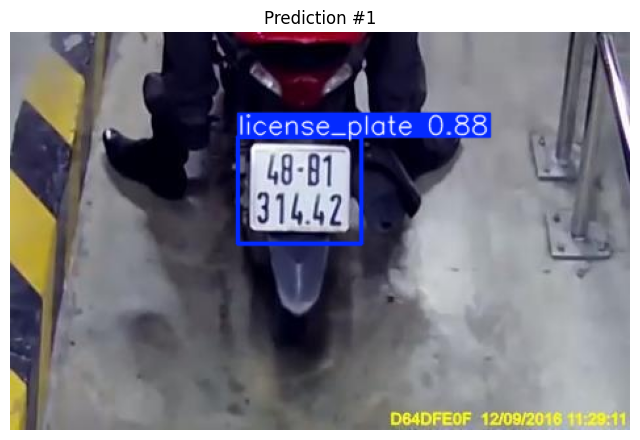

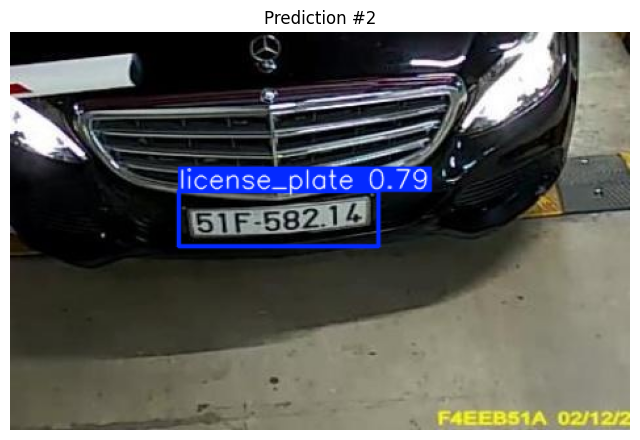

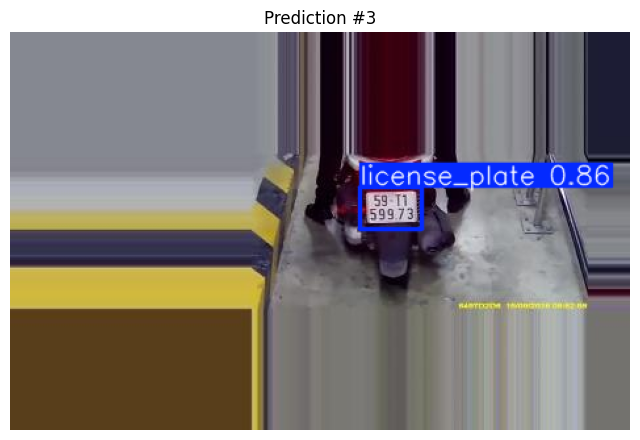

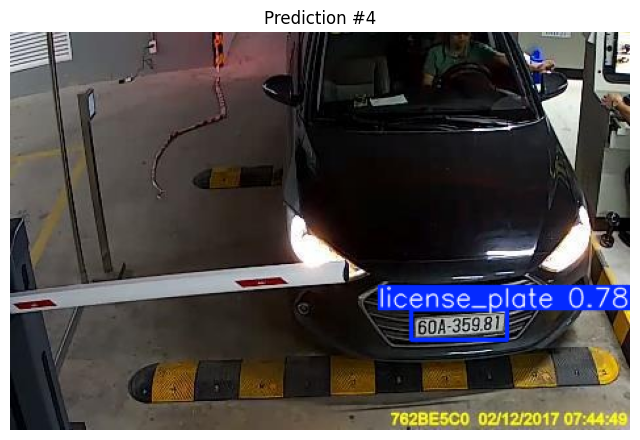

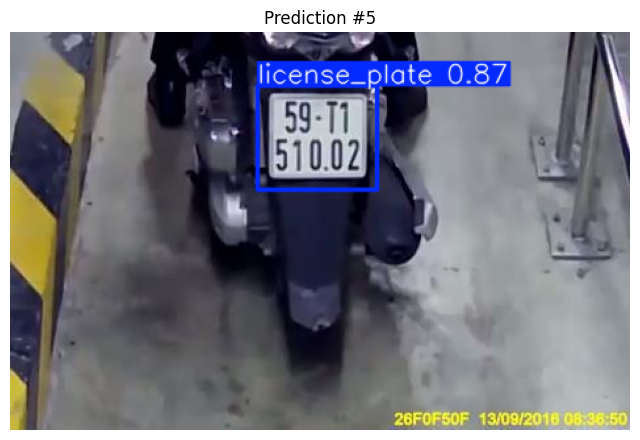

In [10]:
from IPython.display import display
import cv2, matplotlib.pyplot as plt

model = YOLO("runs/detect/train/weights/best.pt")
val_imgs = sorted(glob.glob("/kaggle/working/datasets/dataset/images/val/*.jpg"))[:5]

print(f"🖼️ Found {len(val_imgs)} validation images.")

for i, img_path in enumerate(val_imgs):
    results = model(img_path, verbose=False)
    annotated = results[0].plot()
    if annotated is None:
        print(f"⚠️ Image {i+1}: plot() returned None, retrying with direct draw...")
        annotated = results[0].orig_img  # fallback to raw image if plot() fails

    plt.figure(figsize=(8,6))
    plt.imshow(cv2.cvtColor(annotated, cv2.COLOR_BGR2RGB))
    plt.title(f"Prediction #{i+1}")
    plt.axis("off")
    display(plt.gcf())  
    plt.close()

# 7. Evaluate model on test set 

In [11]:
metrics = model.val(data="dataset.yaml", split="test")  
     
print("\n📊 Test Metrics:")
print(f"mAP50: {metrics.box.map50:.4f}")
print(f"mAP50-95: {metrics.box.map:.4f}")
print(f"Precision: {metrics.box.mp:.4f}")
print(f"Recall: {metrics.box.mr:.4f}")

Ultralytics 8.3.63 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)


val: Scanning /kaggle/working/datasets/dataset/labels/test... 882 images, 0 backgrounds, 0 corrupt: 100%|██████████| 882/882 [00:00<00:00, 1504.46it/s]


val: New cache created: /kaggle/working/datasets/dataset/labels/test.cache


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 56/56 [00:07<00:00,  7.79it/s]


                   all        882        902      0.994      0.971      0.988      0.721
         license_plate        882        902      0.994      0.971      0.988      0.721


/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.2ms preprocess, 4.4ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to /kaggle/working/yolov12/runs/detect/val

📊 Test Metrics:
mAP50: 0.9884
mAP50-95: 0.7207
Precision: 0.9941
Recall: 0.9712


# 8. Visualize ground truth + predictions on test set

🧪 Found 5 test images.


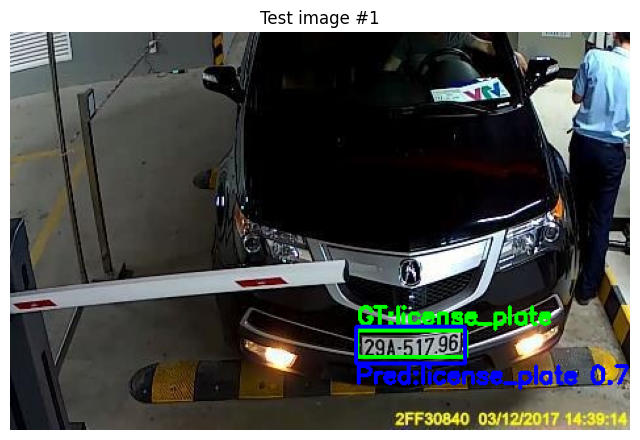

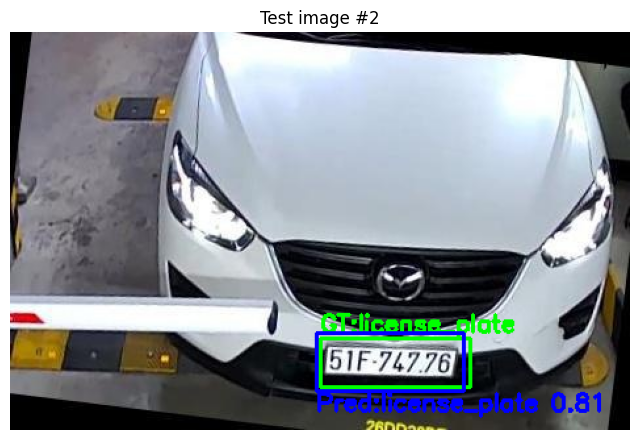

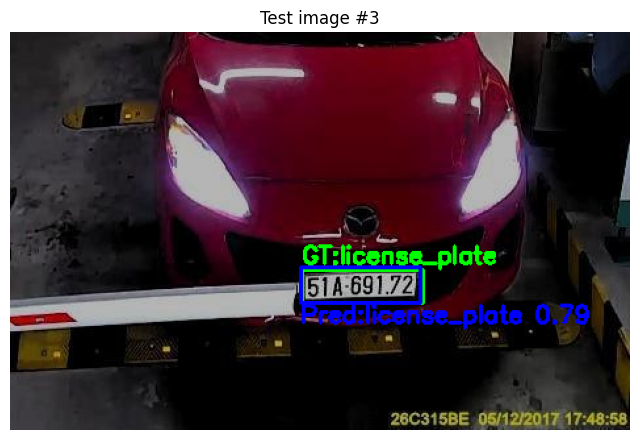

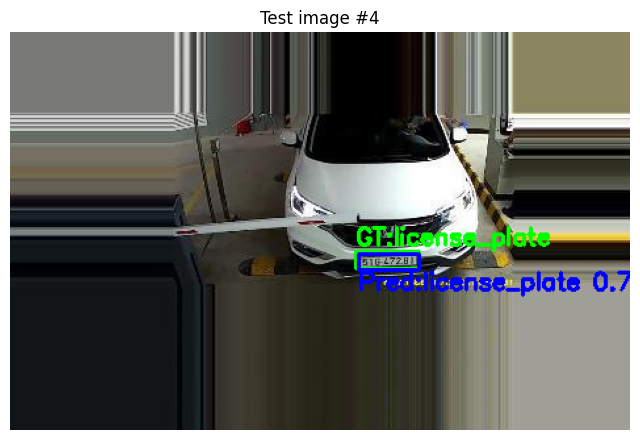

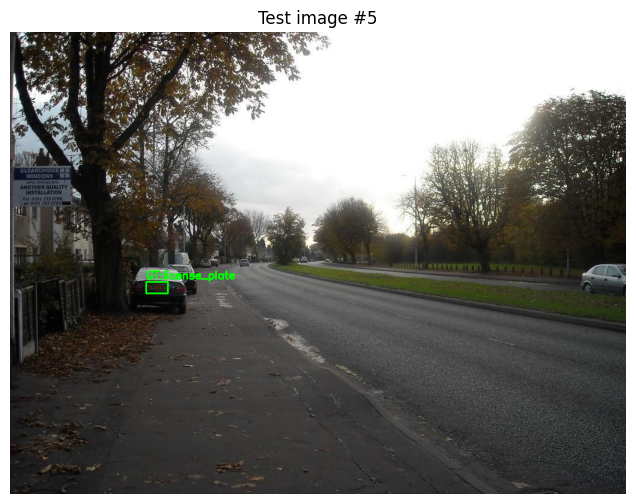

In [12]:
import yaml, cv2, matplotlib.pyplot as plt
from IPython.display import display

with open("dataset.yaml", "r") as f:
    data_yaml = yaml.safe_load(f)
class_names = data_yaml["names"]

def read_labels(img_path):
    label_path = img_path.replace("images", "labels").replace(".jpg", ".txt")
    if not os.path.exists(label_path):
        return []
    with open(label_path, "r") as f:
        labels = [list(map(float, line.strip().split())) for line in f.readlines()]
    return labels

test_imgs = sorted(glob.glob("/kaggle/working/datasets/dataset/images/test/*.jpg"))[:5]
print(f"🧪 Found {len(test_imgs)} test images.")

for i, img_path in enumerate(test_imgs):
    img = cv2.imread(img_path)
    h, w = img.shape[:2]

    # Ground truth (green)
    for cls, x, y, bw, bh in read_labels(img_path):
        x1, y1 = int((x - bw/2)*w), int((y - bh/2)*h)
        x2, y2 = int((x + bw/2)*w), int((y + bh/2)*h)
        cv2.rectangle(img, (x1, y1), (x2, y2), (0,255,0), 2)
        cv2.putText(img, f"GT:{class_names[int(cls)]}", (x1, max(y1-5,15)),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0,255,0), 2)

    # Predictions (blue)
    results = model(img_path, verbose=False)
    for box in results[0].boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        cls_id = int(box.cls[0])
        conf = float(box.conf[0])
        cv2.rectangle(img, (x1, y1), (x2, y2), (255,0,0), 2)
        cv2.putText(img, f"Pred:{class_names[cls_id]} {conf:.2f}", 
                    (x1, y2+15), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,0,0), 2)

    plt.figure(figsize=(8,6))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(f"Test image #{i+1}")
    plt.axis("off")
    display(plt.gcf())   # ✅ ép Kaggle hiển thị
    plt.close()

# 9. Run YOLOv12 on a video and display result

In [13]:
video_path = "/kaggle/input/car-number-plate-video/pexels-casey-whalen-6571483 (2160p).mp4"
             
# Run inference on video 
results = model.predict(    
    source=video_path,
    conf=0.25,
    save=True,
    project="runs/detect",
    name="plate_video",
    stream=False,
    imgsz=1280
)


WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

Results saved to runs/detect/plate_video


In [14]:
# Locate output video generated by YOLO
output_videos = sorted(glob.glob("runs/detect/plate_video/*.avi")) 
if len(output_videos) == 0:
    raise FileNotFoundError("Không tìm thấy video output YOLOv12!")
avi_file = output_videos[-1]  

# Compress AVI → MP4 using ffmpeg for easy playback
compressed_video = "/kaggle/working/detected_plate_video.mp4"
ffmpeg_command = [
    "ffmpeg", "-y", "-i", avi_file, "-vcodec", "libx264",
    "-crf", "28", "-preset", "fast", compressed_video
]
subprocess.run(ffmpeg_command, stdout=subprocess.PIPE, stderr=subprocess.PIPE)
print("✅ Video compressed!")

✅ Video compressed!


In [15]:
# Function to embed video in notebook
def play_video(file_path, width=800):
    try:
        with open(file_path, "rb") as video_file:
            video_data = video_file.read()
            video_base64 = b64encode(video_data).decode()
    except FileNotFoundError:
        return HTML("<p style='color:red;'>🚨 Error: Video file not found!</p>")
      
    video_html = f"""
    <video width="{width}" controls autoplay loop>
        <source src="data:video/mp4;base64,{video_base64}" type="video/mp4">
        Your browser does not support the video tag.
    </video>
    """
    return HTML(video_html)

# Display video directly in Kaggle output cell
play_video(compressed_video, width=1000)